# Intel Image Classification

This dataset features 25,000 images of natural scenes categorized into six classes. It includes training ~14k), testing ~3k), and prediction ~7k) data
 Originally provided by Intel for a challenge on Kaggle.

# Importing Libraries

In [ ]:
import os
#import glob as gb
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import cv2
import keras
import tensorflow as tf
#from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing.image import load_img, img_to_array , ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping
from PIL import Image
import concurrent.futures

# Exploring The Data

In [ ]:
# Get the current working directory
main_dir = os.getcwd()

# Create relative paths to the directories
train_path = os.path.join(main_dir,  'cnn_img', 'seg_train', 'seg_train')
test_path = os.path.join(main_dir,  'cnn_img', 'seg_test', 'seg_test')
pred_path = os.path.join(main_dir,  'cnn_img', 'seg_pred', 'seg_pred')

In [ ]:
# Function to get image size and number of channels
def get_image_info(image_path):
    try:
        with Image.open(image_path) as img:
            size = img.size  # (width, height)
            mode = img.mode
            if mode == 'RGB':
                channels = 3
            elif mode == 'RGBA':
                channels = 4
            elif mode == 'L':
                channels = 1
            else:
                channels = None
            return size[0], size[1], channels
    except Exception as e:
        return None

In [ ]:
# Function to collect all image paths from the main folder and subfolders
def collect_image_paths(main_directory, extensions=('.jpg', '.png', '.jpeg')):
    return [os.path.join(root, file)
            for root, _, files in os.walk(main_directory)
            for file in files if file.lower().endswith(extensions)]

In [ ]:
# Function to process images in parallel and get their sizes and channels
def collect_image_info(image_paths):
    with concurrent.futures.ThreadPoolExecutor() as executor:
        return [res for res in executor.map(get_image_info, image_paths) if res]

In [ ]:
# Main workflow
def process_images_from_directory(main_dir):
    image_paths = collect_image_paths(main_dir)
    image_info = collect_image_info(image_paths)
    df_train = pd.DataFrame(image_info, columns=['Width', 'Height', 'Channels'])
    df_counts = df_train.value_counts().reset_index(name='Count')
    return df_counts

In [ ]:
# Example usage:
df_train = process_images_from_directory(main_dir)

In [ ]:
df_train.head()

,Width,Height,Channels,Count
0,150,150,3,48534
1,150,113,3,14
2,150,135,3,6
3,150,149,3,6
4,150,131,3,6


# Data Importing and Augmentation

In [ ]:
# image data generator for train
train_datagen = ImageDataGenerator(rescale=1./255)
train_generator = train_datagen.flow_from_directory(
  train_path,          # path to train data
  target_size=(150, 150),   # size image
  batch_size=32,
  class_mode='categorical'
)

Found 14034 images belonging to 6 classes.


In [ ]:
# image data generator for validation
test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(
  test_path,            # path to validation data
  target_size=(150, 150),   # size image
  batch_size=32,
  class_mode='categorical'
)

Found 3000 images belonging to 6 classes.


# Building CNN Archticture

In [ ]:
model_Manual = keras.models.Sequential([
    keras.layers.Conv2D(filters=160, kernel_size=(3,3), activation='relu', input_shape=(150,150,3)),
    keras.layers.Conv2D(filters=100, kernel_size=(3,3), activation='relu'),
    keras.layers.MaxPooling2D(4,4),

    keras.layers.Conv2D(filters=80, kernel_size=(3,3), activation='relu'),
    keras.layers.Conv2D(filters=40, kernel_size=(3,3), activation='relu'),
    keras.layers.MaxPooling2D(4,4),

    keras.layers.Flatten(),

    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dropout(0.3),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dropout(0.1),
    keras.layers.Dense(6, activation='softmax')
])

In [ ]:
model_Manual.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 160)     4480      
                                                                 
 conv2d_1 (Conv2D)           (None, 146, 146, 100)     144100    
                                                                 
 max_pooling2d (MaxPooling2D  (None, 36, 36, 100)      0         
 )                                                               
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 80)        72080     
                                                                 
 conv2d_3 (Conv2D)           (None, 32, 32, 40)        28840     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 8, 8, 40)         0         
 2D)                                                    

In [ ]:
model_Manual.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

# Model Training and Evaluation

In [ ]:
history = model_Manual.fit(
    train_generator,
    epochs=20,
    batch_size=32,
    verbose=1,
    validation_data=test_generator,
    callbacks=[early_stopping])

Epoch 1/20
439/439 [==============================] - 78s 146ms/step - loss: 1.1567 - accuracy: 0.5170 - val_loss: 0.8946 - val_accuracy: 0.6163
Epoch 2/20
439/439 [==============================] - 60s 136ms/step - loss: 0.8491 - accuracy: 0.6635 - val_loss: 0.6841 - val_accuracy: 0.7487
Epoch 3/20
439/439 [==============================] - 60s 136ms/step - loss: 0.6912 - accuracy: 0.7476 - val_loss: 0.5514 - val_accuracy: 0.7983
Epoch 4/20
439/439 [==============================] - 60s 136ms/step - loss: 0.5756 - accuracy: 0.7947 - val_loss: 0.5344 - val_accuracy: 0.8217
Epoch 5/20
439/439 [==============================] - 60s 136ms/step - loss: 0.4826 - accuracy: 0.8283 - val_loss: 0.5840 - val_accuracy: 0.7873
Epoch 6/20
439/439 [==============================] - 60s 136ms/step - loss: 0.4568 - accuracy: 0.8370 - val_loss: 0.4235 - val_accuracy: 0.8547
Epoch 7/20
439/439 [==============================] - 60s 136ms/step - loss: 0.3876 - accuracy: 0.8649 - val_loss: 0.4431 - val_ac

In [ ]:
test_loss, test_accuracy = model_Manual.evaluate(test_generator, verbose=1)
print(f"Test accuracy: {test_accuracy:.4f}")

94/94 [==============================] - 3s 35ms/step - loss: 0.4235 - accuracy: 0.8547
Test accuracy: 0.8547


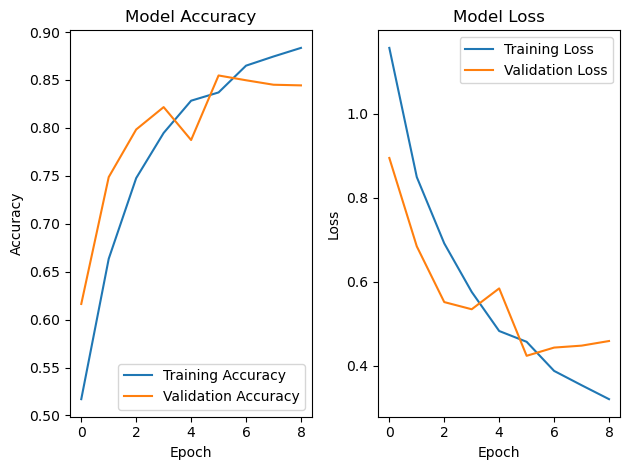

In [ ]:
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

# Model Testing

In [ ]:
class_names = os.listdir(train_path)
class_names_label = {class_name: i for i, class_name in enumerate(class_names)}
print(class_names_label)
print(class_names)

{'buildings': 0, 'forest': 1, 'glacier': 2, 'mountain': 3, 'sea': 4, 'street': 5}
['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']


In [ ]:
# Create an ImageDataGenerator for preprocessing
datagen = ImageDataGenerator(rescale=1./255)

# List all image files in the folder
image_files = [f for f in os.listdir(pred_path) if os.path.isfile(os.path.join(pred_path, f))]

# Check if there are any images
if not image_files:
    raise ValueError("No images found in the specified folder.")

In [ ]:
# Randomly select images
selected_images = random.sample(image_files, min(50, len(image_files)))

# Function to load and preprocess image
def load_and_preprocess_image(image_path, target_size):
    img = load_img(image_path, target_size=target_size)
    img_array = img_to_array(img) / 255.0  # Normalize
    return np.expand_dims(img_array, axis=0)

# Load and preprocess images
batch_images = []
for image_file in selected_images:
    image_path = os.path.join(pred_path, image_file)
    batch_images.append(load_and_preprocess_image(image_path, target_size=(150, 150)))

# Convert list to numpy array
batch_images = np.vstack(batch_images)

In [ ]:
# Classify the batch
predictions = model_Manual.predict(batch_images)

2/2 [==============================] - 0s 34ms/step


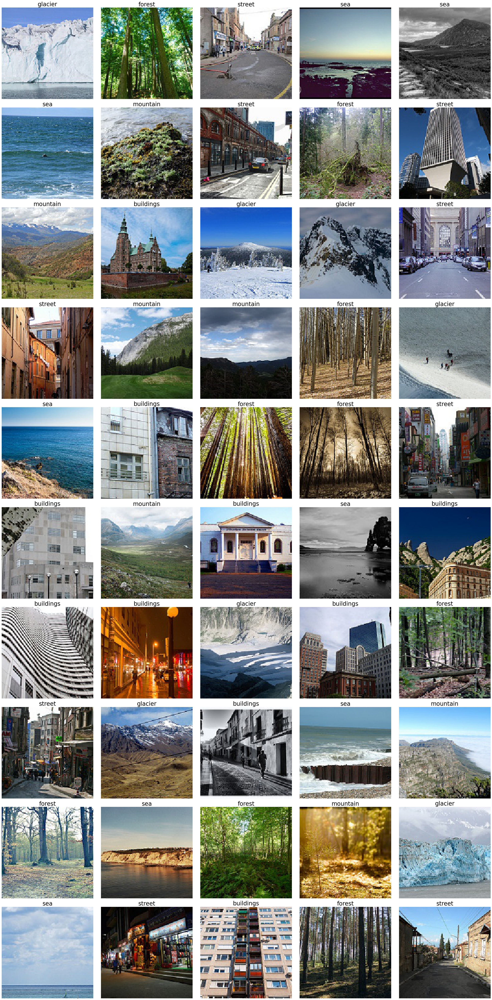

In [ ]:
plt.figure(figsize=(30, 60))

# Loop through the 50 images and predictions
for i in range(50):
    image_file = selected_images[i]

    # Get the predicted class index
    predicted_class_index = np.argmax(predictions[i])

    # Map the predicted class index to the class name
    predicted_class = class_names[predicted_class_index]

    # Load the image for display with the original size
    img_display = load_img(os.path.join(pred_path, image_file), target_size=(200, 200))

    # Plot the image
    plt.subplot(10, 5, i + 1)
    plt.imshow(img_display)
    plt.title(predicted_class, fontsize=25)
    plt.axis('off')

# Show the plot
plt.tight_layout()
plt.show()

# Save Weights

In [ ]:
import pickle

weights = model_Manual.get_weights()

# Save weights using pickle
with open('model_weights.pkl', 'wb') as f:
    pickle.dump(weights, f)

# Restore Weights

In [ ]:
""" import pickle

with open('model_weights.pkl', 'rb') as f:
    weights = pickle.load(f)

# Set the weights to the model
model.set_weights(weights)"""

# By Transfer Learning

In [ ]:
from tensorflow.keras.applications import InceptionV3

In [ ]:
# Load InceptionV1 model pre-trained on ImageNet, excluding the top (classification) layer
base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=(150, 150, 3))

In [ ]:
# Add custom layers on top of the base model
#same as the first NN last layers
x = base_model.output
x = keras.layers.Flatten()(x)
x = keras.layers.Dense(128, activation='relu')(x)
x = keras.layers.Dropout(0.3)(x)
x = keras.layers.Dense(64, activation='relu')(x)
x = keras.layers.Dropout(0.1)(x)
predictions = keras.layers.Dense(6, activation='softmax')(x)

In [ ]:
# Define the full model
model_Google = keras.models.Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model_Google.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

In [ ]:
history_Google = model_Google.fit(
    train_generator,
    epochs=20,
    batch_size=32,
    verbose=1,
    validation_data=test_generator,
    callbacks=[early_stopping])

Epoch 1/20
439/439 [==============================] - 53s 105ms/step - loss: 0.9123 - accuracy: 0.6924 - val_loss: 1.7436 - val_accuracy: 0.4463
Epoch 2/20
439/439 [==============================] - 44s 100ms/step - loss: 0.6778 - accuracy: 0.7705 - val_loss: 1.8509 - val_accuracy: 0.6627
Epoch 3/20
439/439 [==============================] - 44s 100ms/step - loss: 0.5194 - accuracy: 0.8348 - val_loss: 0.6155 - val_accuracy: 0.7703
Epoch 4/20
439/439 [==============================] - 44s 101ms/step - loss: 0.4707 - accuracy: 0.8504 - val_loss: 1.0621 - val_accuracy: 0.7577
Epoch 5/20
439/439 [==============================] - 44s 101ms/step - loss: 0.4007 - accuracy: 0.8698 - val_loss: 0.3897 - val_accuracy: 0.8740
Epoch 6/20
439/439 [==============================] - 45s 102ms/step - loss: 0.3790 - accuracy: 0.8839 - val_loss: 0.4962 - val_accuracy: 0.8443
Epoch 7/20
439/439 [==============================] - 45s 101ms/step - loss: 0.3357 - accuracy: 0.8945 - val_loss: 0.5250 - val_ac

In [ ]:
model_Google.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_4 (Conv2D)              (None, 74, 74, 32)   864         ['input_1[0][0]']                
                                                                                                  
 batch_normalization (BatchNorm  (None, 74, 74, 32)  96          ['conv2d_4[0][0]']               
 alization)                                                                                       
                                                                                              